# Running batch correction (with `harmony`) for the mouse and human atlas datasets

In [1]:
import scanpy as sc
import scanpy.external as sce
import pandas as pd

import random
import gc
import os
import seaborn as sns

In [2]:
WORKDIR="/workdir/dwm269/scMuscle2"
os.chdir(WORKDIR)

In [3]:
gc.enable()

In [4]:
NCORES=16
sc.settings.n_jobs = NCORES

In [5]:
from scripts.py.scantils import *
# from scripts.py.scanplots import *

## Mouse

In [6]:
mouse = sc.read_h5ad("data/atlas/mus_musculus_pp.h5ad")
mouse.shape

(1802328, 392)

In [7]:
sce.pp.harmony_integrate(
    mouse,
    basis="X_pca",
    adjusted_basis="X_pca_harmony",
    key="GSM.accession"
)

2023-09-18 19:59:06,727 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2023-09-18 20:09:17,978 - harmonypy - INFO - sklearn.KMeans initialization complete.
2023-09-18 20:09:47,587 - harmonypy - INFO - Iteration 1 of 10
2023-09-18 22:31:23,547 - harmonypy - INFO - Iteration 2 of 10
2023-09-19 01:02:51,309 - harmonypy - INFO - Converged after 2 iterations


In [8]:
reorder_reduction(
    mouse,
    reduction="X_pca_harmony",
    verbose=True
)

Reduction variance by dimension:
[4.6818786, 5.7671294, 0.55525935, 2.264322, 3.1153529, 3.0277944, 2.1071682, 2.2938633, 2.5502179, 2.2160866, 1.9475999, 1.4766585, 1.4049438, 1.5725006, 1.2655585, 0.74847794, 1.0732796, 1.0721811, 1.0207006, 0.85430664, 0.9497545, 0.8370244, 0.81916136, 0.88147116, 0.91393137, 0.70957816, 0.7833463, 0.7722344, 0.7854729, 0.56667376, 0.7329128, 0.7464254, 0.6578711, 0.70169544, 0.5877547, 0.673269, 0.6795923, 0.7213473, 0.6991909, 0.6897872, 0.6434737, 0.6650632, 0.649831, 0.664529, 0.65114117, 0.6968005, 0.64200175, 0.6851178, 0.66642416, 0.66570216]


In [9]:
sc.pp.neighbors(
    mouse,
    n_neighbors=50,
    n_pcs=npcs(mouse, reduction="X_pca_harmony"),
    use_rep="X_pca_harmony",
    key_added="harmony_knn"
)
gc.collect()

48339

In [10]:
sc.tl.leiden(
    mouse,
    resolution=1.2,
    neighbors_key="harmony_knn", 
    key_added=f"harmony_{1.2}"
)

In [11]:
sc.tl.umap(
    mouse,
    neighbors_key="harmony_knn"
)

/home/dwm269/miniconda3/envs/scm2/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/dwm269/miniconda3/envs/scm2/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/dwm269/miniconda3/envs/scm2/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


/home/dwm269/miniconda3/envs/scm2/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


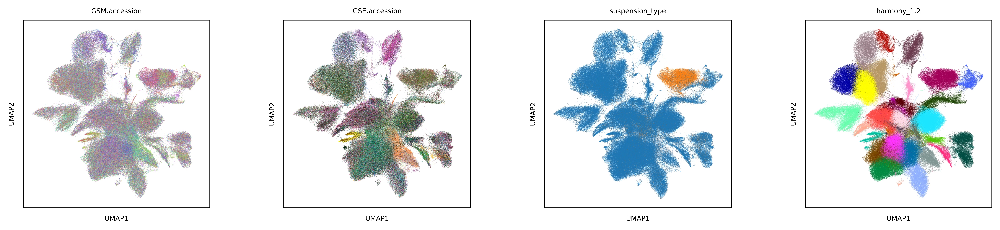

In [12]:
sc.set_figure_params(
    figsize=(3,3),
    fontsize=6,
    transparent=False,
    dpi=300
)

sc.pl.umap(
    mouse,
    legend_loc=None, 
    color=["GSM.accession","GSE.accession","suspension_type","harmony_1.2"],
    save="mouse_gsm_umap_harmony.png"
)

In [13]:
mouse.write_h5ad(
    "data/atlas/mus_musculus_pp_harmony.h5ad"
)

In [14]:
# if os.path.exists("data/atlas/mus_musculus_pp_harmony.h5ad"):
#     del mouse

## Human

Load human data...

In [15]:
human = sc.read_h5ad("data/atlas/homo_sapiens_pp.h5ad")
human.shape

(1146214, 475)

In [16]:
sce.pp.harmony_integrate(
    human,
    basis="X_pca",
    adjusted_basis="X_pca_harmony",
    key="GSM.accession"
)

2023-09-19 08:46:53,833 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2023-09-19 08:54:23,407 - harmonypy - INFO - sklearn.KMeans initialization complete.
2023-09-19 08:54:36,089 - harmonypy - INFO - Iteration 1 of 10
2023-09-19 09:33:17,018 - harmonypy - INFO - Iteration 2 of 10
2023-09-19 10:14:21,674 - harmonypy - INFO - Converged after 2 iterations


In [17]:
reorder_reduction(
    human,
    reduction="X_pca_harmony",
    verbose=True
)

Reduction variance by dimension:
[3.7806208, 2.637529, 3.7868462, 1.2823721, 1.9023895, 1.4307406, 1.6432546, 1.60579, 0.96517307, 0.74986845, 1.1129649, 1.1362464, 0.9682291, 0.7156096, 0.92301744, 0.8462944, 0.7335294, 0.58279127, 0.6606066, 0.6180809, 0.5762603, 0.63357866, 0.6174981, 0.7424362, 0.69369125, 0.6903287, 0.6813947, 0.67578715, 0.65313864, 0.56843823, 0.5480626, 0.66335034, 0.5564228, 0.6289089, 0.6176508, 0.66912234, 0.569084, 0.61831814, 0.64389586, 0.62740016, 0.64798015, 0.5949193, 0.602701, 0.6492567, 0.66271704, 0.6645536, 0.67130625, 0.64922684, 0.6435664, 0.61770123]


In [18]:
sc.pp.neighbors(
    human,
    n_neighbors=50,
    n_pcs=npcs(human, reduction="X_pca_harmony"),
    use_rep="X_pca_harmony",
    key_added="harmony_knn"
)
gc.collect()

36507

In [19]:
sc.tl.leiden(
    human,
    resolution=1.2,
    neighbors_key="harmony_knn", 
    key_added=f"harmony_{1.2}"
)
gc.collect()

0

In [20]:
sc.tl.umap(
    human,
    neighbors_key="harmony_knn"
)
gc.collect()

30070

In [21]:
palette=sns.color_palette(
    "hls", 
    len(human.obs["GSM.accession"].unique())
)
random.shuffle(palette)
human.uns['GSM.accession_colors'] =  ["#{:02x}{:02x}{:02x}".format(int(r * 255), int(g * 255), int(b * 255)) for r, g, b in palette]

/home/dwm269/miniconda3/envs/scm2/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/dwm269/miniconda3/envs/scm2/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/dwm269/miniconda3/envs/scm2/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


/home/dwm269/miniconda3/envs/scm2/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


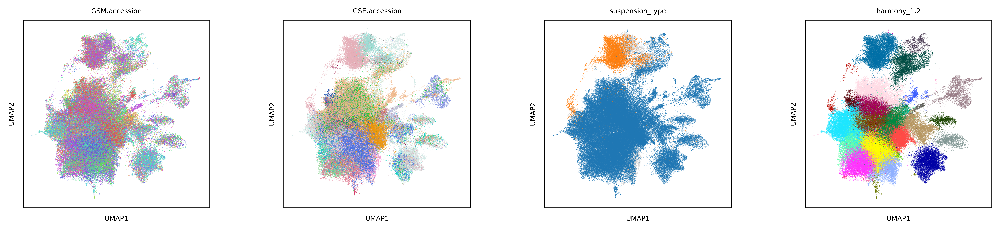

In [22]:
sc.set_figure_params(
    figsize=(3,3),
    fontsize=6,
    transparent=False,
    dpi=300
)

sc.pl.umap(
    human,
    legend_loc=None, 
    color=["GSM.accession","GSE.accession","suspension_type","harmony_1.2"],
    save="human_gsm_umap_harmony.png"
)

In [23]:
human.write_h5ad(
    "data/atlas/homo_sapiens_pp_harmony.h5ad"
)

In [24]:
# if os.path.exists("data/atlas/homo_sapiens_pp_harmony.h5ad"):
#     del human